In [3]:
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sklearn

## 1) EDA

In [4]:
# Set the maximum number of displayed columns to 100
pd.set_option('display.max_columns', 100)


In [5]:
# read the data
df_original = pd.read_parquet("/Users/dnn/Data Science for Business 23-25/Master 1 - X/Python for Data Science/Sam_Solal_projet/data/train.parquet")
# Ajouter une nouvelle colonne d'index de 1 au nombre de lignes
df_original['index'] = range(1, len(df_original) + 1)
df_original

,counter_id,counter_name,site_id,site_name,bike_count,date,counter_installation_date,counter_technical_id,latitude,longitude,log_bike_count,index
48321,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,0.0,2020-09-01 02:00:00,2013-01-18,Y2H15027244,48.846028,2.375429,0.000000,1
48324,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,1.0,2020-09-01 03:00:00,2013-01-18,Y2H15027244,48.846028,2.375429,0.693147,2
48327,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,0.0,2020-09-01 04:00:00,2013-01-18,Y2H15027244,48.846028,2.375429,0.000000,3
48330,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,4.0,2020-09-01 15:00:00,2013-01-18,Y2H15027244,48.846028,2.375429,1.609438,4
48333,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,9.0,2020-09-01 18:00:00,2013-01-18,Y2H15027244,48.846028,2.375429,2.302585,5
...,...,...,...,...,...,...,...,...,...,...,...,...
928450,300014702-353245971,254 rue de Vaugirard SO-NE,300014702,254 rue de Vaugirard,51.0,2021-08-08 18:00:00,2020-11-29,Y2H20114504,48.839770,2.301980,3.951244,455159
928453,300014702-353245971,254 rue de Vaugirard SO-NE,300014702,254 rue de Vaugirard,1.0,2021-08-09 02:00:00,2020-11-29,Y2H20114504,48.839770,2.301980,0.693147,455160
928456,300014702-353245971,254 rue de Vaugirard SO-NE,300014702,254 rue de Vaugirard,61.0,2021-08-09 08:00:00,2020-11-29,Y2H20114504,48.839770,2.301980,4.127134,455161
928459,300014702-353245971,254 rue de Vaugirard SO-NE,300014702,254 rue de Vaugirard,44.0,2021-08-09 10:00:00,2020-11-29,Y2H20114504,48.839770,2.301980,3.806662,455162


In [6]:
df_original.nunique(axis=0)

counter_id                       56
counter_name                     56
site_id                          30
site_name                        30
bike_count                      977
date                           8230
counter_installation_date        22
counter_technical_id             30
latitude                         30
longitude                        30
log_bike_count                  977
index                        455163
dtype: int64

In [7]:
df_original.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 455163 entries, 48321 to 928462
Data columns (total 12 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   counter_id                 455163 non-null  category      
 1   counter_name               455163 non-null  category      
 2   site_id                    455163 non-null  int64         
 3   site_name                  455163 non-null  category      
 4   bike_count                 455163 non-null  float64       
 5   date                       455163 non-null  datetime64[ns]
 6   counter_installation_date  455163 non-null  datetime64[ns]
 7   counter_technical_id       455163 non-null  category      
 8   latitude                   455163 non-null  float64       
 9   longitude                  455163 non-null  float64       
 10  log_bike_count             455163 non-null  float64       
 11  index                      455163 non-null  int6

There are 455 163 observations in the training data set and 9 predictor variables. However some of them like `site_name` and `site_id`, or `counter_name` and `counter_id` are redundant and both should not be included in the model. Also,  `site_id` is an int so we should remember it is a categorical variable if we want to use it in our model. <br>
Finally, there are no missing values. 
Let us now perform the merge and check how is the df.

Most frequented storeations:

In [8]:
df_original.groupby(["site_name", "counter_name"], observed=True)["log_bike_count"].sum().sort_values(ascending = False).to_frame()

log_bike_count
site_name                                 counter_name                                                   
Totem 73 boulevard de Sébastopol          Totem 73 boulevard de Sébastopol S-N               37697.028313
                                          Totem 73 boulevard de Sébastopol N-S               35964.802926
Totem 64 Rue de Rivoli                    Totem 64 Rue de Rivoli O-E                         34775.808621
67 boulevard Voltaire SE-NO               67 boulevard Voltaire SE-NO                        33352.816751
27 quai de la Tournelle                   27 quai de la Tournelle SE-NO                      31870.111864
Totem 64 Rue de Rivoli                    Totem 64 Rue de Rivoli E-O                         31714.602318
Face au 48 quai de la marne               Face au 48 quai de la marne SO-NE                  30847.893814
Totem Cours la Reine                      Totem Cours la Reine O-E                           30263.155124
Face au 48 quai de la marne               Face au 48 quai de la marne NE-SO                  29996.856798
Quai d'Orsay                              Quai d'Orsay E-O                                   29951.220338
Totem 85 quai d'Austerlitz                Totem 85 quai d'Austerlitz SE-NO                   29838.581644
38 rue Turbigo                            38 rue Turbigo NE-SO                               29389.100421
                                          38 rue Turbigo SO-NE                               29097.393983
36 quai de Grenelle                       36 quai de Grenelle NE-SO                          28913.477829
90 Rue De Sèvres                          90 Rue De Sèvres NE-SO                             28301.067290
27 quai de la Tournelle                   27 quai de la Tournelle NO-SE                      28282.804684
Pont de la Concorde S-N                   Pont de la Concorde S-N                            27777.315506
Totem 85 quai d'Austerlitz                Totem 85 quai d'Austerlitz NO-SE                   27416.801591
Face au 25 quai de l'Oise                 Face au 25 quai de l'Oise SO-NE                    27279.743158
Quai d'Orsay                              Quai d'Orsay O-E                                   26929.793612
39 quai François Mauriac                  39 quai François Mauriac NO-SE                     26278.230413
                                          39 quai François Mauriac SE-NO                     26075.139025
Face au 25 quai de l'Oise                 Face au 25 quai de l'Oise NE-SO                    26000.935231
6 rue Julia Bartet                        6 rue Julia Bartet NE-SO                           25999.226413
28 boulevard Diderot                      28 boulevard Diderot O-E                           25342.042229
Voie Georges Pompidou                     Voie Georges Pompidou SO-NE                        24886.867695
36 quai de Grenelle                       36 quai de Grenelle SO-NE                          24857.466677
Totem Cours la Reine                      Totem Cours la Reine E-O                           24515.766951
Pont de Bercy                             Pont de Bercy NE-SO                                23607.103438
Face au 4 avenue de la porte de Bagnolet  Face au 4 avenue de la porte de Bagnolet E-O       23571.370531
6 rue Julia Bartet                        6 rue Julia Bartet SO-NE                           23521.742116
Face au 70 quai de Bercy                  Face au 70 quai de Bercy N-S                       23487.393171
18 quai de l'Hôtel de Ville               18 quai de l'Hôtel de Ville SE-NO                  23392.555432
Face 104 rue d'Aubervilliers              Face 104 rue d'Aubervilliers N-S                   23280.299902
152 boulevard du Montparnasse             152 boulevard du Montparnasse E-O                  23251.359158
Pont Charles De Gaulle                    Pont Charles De Gaulle NE-SO                       23096.685286
Pont de Bercy                             Pont de Bercy SO-NE  

# Idea:  Gap Encoder pour counter name et site name 

In [9]:
import folium

m = folium.Map(location=df_original[["latitude", "longitude"]].mean(axis=0), zoom_start=13)

for _, row in (
    df_original[["counter_name", "latitude", "longitude"]]
    .drop_duplicates("counter_name")
    .iterrows()
):
    folium.Marker(
        row[["latitude", "longitude"]].values.tolist(), popup=row["counter_name"]
    ).add_to(m)

m

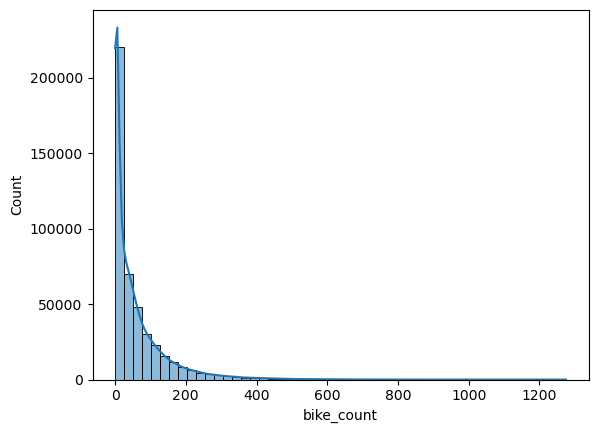

In [10]:
import seaborn as sns


ax = sns.histplot(df_original, x="bike_count", kde=True, bins=50)

Least square loss would not be appropriate to model it since it is designed for normal error distributions. One way to precede would be to transform the variable with a logarithmic transformation,
```py
data['log_bike_count'] = np.log(1 + data['bike_count'])
```

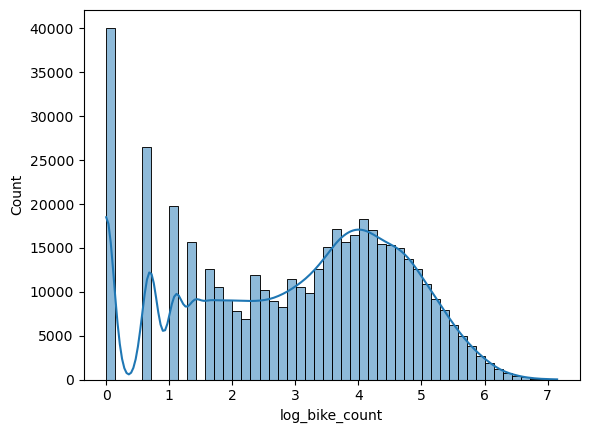

In [11]:
import seaborn as sns


ax = sns.histplot(df_original, x="log_bike_count", kde=True, bins=50)

which has a more pronounced central mode, but is still non symmetric. In the following, **we use `log_bike_count` as the target variable** as otherwise `bike_count` ranges over 3 orders of magnitude and least square loss would be dominated by the few large values. 

Note that in this RAMP problem we consider only the 30 most frequented counting sites, to limit data size.

Next we will look into the temporal distribution of the most frequented bike counter. If we plot it directly we will not see much because there are half a million data points,

we agregate by weeks to have a better overview

<Axes: xlabel='date'>

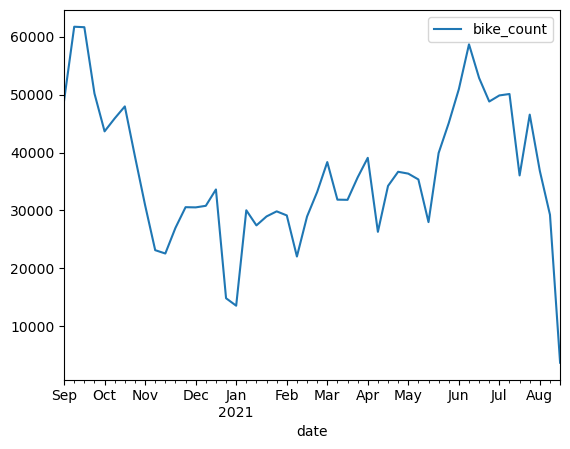

In [12]:
mask = df_original["counter_name"] == "Totem 73 boulevard de Sébastopol S-N"

df_original[mask].groupby(pd.Grouper(freq="1w", key="date"))[["bike_count"]].sum().plot()

<Axes: xlabel='date', ylabel='log_bike_count'>

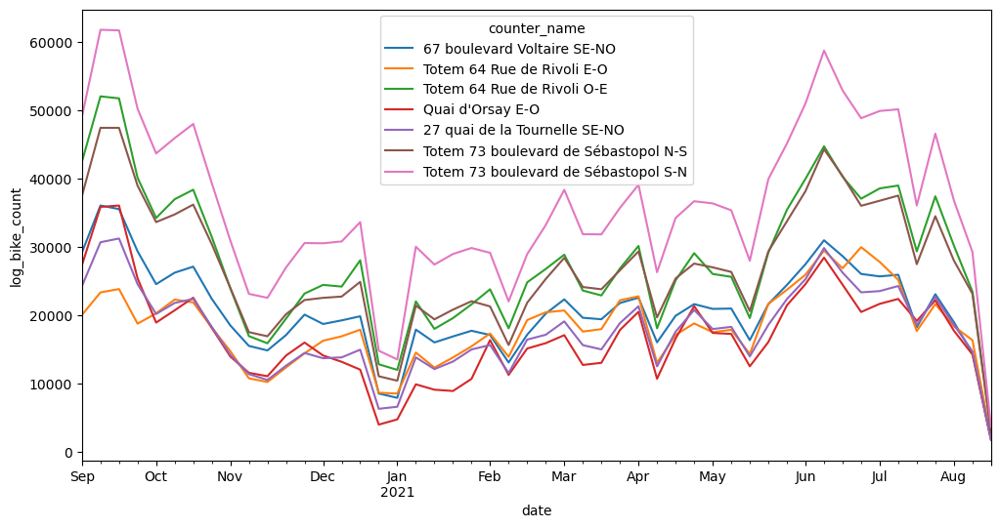

In [13]:
# We want to aggregate more counters on the same plot, we think that 7 is a good number to observe a trend.
# Find the top 10 counters by total bike count
top_counters = df_original.groupby("counter_name", observed = True)["bike_count"].sum().nlargest(7).index

# Create a mask for these top counters
mask = df_original["counter_name"].isin(top_counters)

# Group by week and plot
df_original[mask].groupby(["counter_name", pd.Grouper(freq="1w", key="date")], observed = True)["bike_count"].sum().unstack(0).plot(figsize = (12,6), legend = 'upper right', ylabel='log_bike_count')



We can see that there is a real trend based on the period, we will see why? It is probably a period of lockdown or holidays(Chrismas).



<Axes: xlabel='date', ylabel='log_bike_count'>

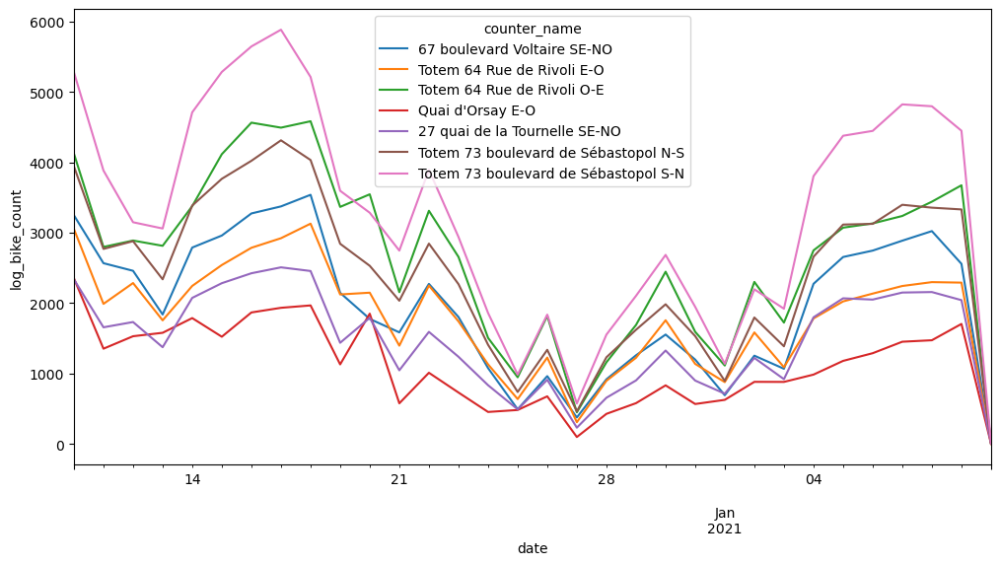

In [14]:
# We want to aggregate more counters on the same plot, we think that 7 is a good number to observe a trend.
# Find the top 10 counters by total bike count
top_counters = df_original.groupby("counter_name", observed = True)["bike_count"].sum().nlargest(7).index

mask_christmas = ( df_original["counter_name"].isin(top_counters)    
       & (df_original["date"] >= "2020-12-10")
       & (df_original["date"] <= "2021-01-10") )

# Group by week and plot
df_original[mask_christmas].groupby(["counter_name", pd.Grouper(freq="1d", key="date")], observed = True)["bike_count"].sum().unstack(0).plot(figsize = (12,6), legend = 'upper right', ylabel='log_bike_count')




We can clearly see a drop in the christmas holidays in Paris : samedi 18 décembre 2020 au lundi 3 janvier 2021.

While at the same time, we can zoom on a week in particular for a more short-term visualization,

<Axes: title={'center': 'for one week'}, xlabel='date'>

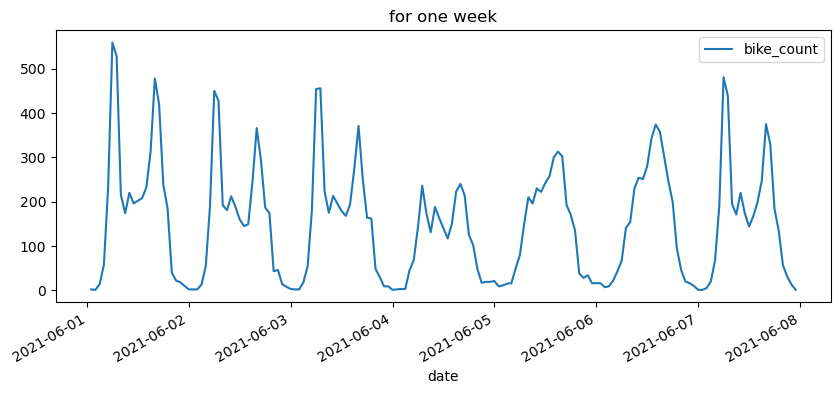

In [14]:
fig, ax = plt.subplots(figsize=(10, 4))

mask = (
    (df_original["counter_name"] == "27 quai de la Tournelle SE-NO")
    & (df_original["date"] > pd.to_datetime("2021/06/01"))
    & (df_original["date"] < pd.to_datetime("2021/06/08"))
)

df_original[mask].plot(x="date", y="bike_count", ax=ax, title="for one week")

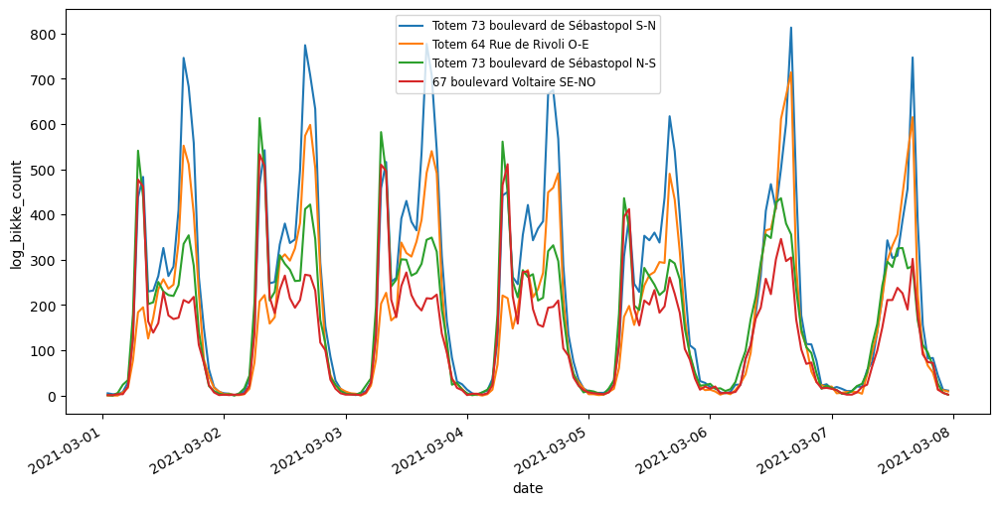

In [15]:
top_counters = df_original.groupby("counter_name", observed = True)["bike_count"].sum().nlargest(4).index

# Time frame
start_date = pd.to_datetime("2021/03/01")
end_date = pd.to_datetime("2021/03/08")

# Initialize plot
fig, ax = plt.subplots(figsize=(12, 6))

# Plot each of the top counters
for counter in top_counters:
    mask = (
        (df_original["counter_name"] == counter) &
        (df_original["date"] > start_date) &
        (df_original["date"] < end_date)
    )
    df_original[mask].plot(x="date", y="bike_count", ax=ax, label=counter, ylabel="log_bikke_count")

# Customize the plot
plt.legend(fontsize='small')
plt.show()


cycle en fonction des heures

## EDA of External Data

In [15]:
!pip install vacances-scolaires-france
!pip install jours_feries_france


In [15]:
from vacances_scolaires_france import SchoolHolidayDates
from jours_feries_france import JoursFeries
from datetime import datetime

# open the data file
df_external = pd.read_csv("/Users/dnn/Data Science for Business 23-25/Master 1 - X/Python for Data Science/Sam_Solal_projet/submissions/external_data/external_data.csv")

# create the quarantine columns
df_external["quarantine1"] = np.where(
    (df_external["date"] <= "2020-12-15") & (df_external["date"] >= "2020-10-30"), 1, 0)
df_external["quarantine2"] = np.where(
    (df_external["date"] <= "2021-05-03") & (df_external["date"] >= "2021-04-03"), 1, 0)
df_external["christmas"] = np.where(
    (df_external["date"] >= "2020-12-19") & (df_external["date"] <= "2021-01-03"), 1, 0)

#creating two new variables, holiday and bank_holiday to represent whether a given date is a school holiday or a bank holiday
hol = SchoolHolidayDates()

df_external['holiday'] = df_external.apply(
    lambda row: hol.is_holiday_for_zone(datetime.strptime(row["date"], '%Y-%m-%d %H:%M:%S').date(), 'C'), axis=1)

df_external['bank_holiday'] = df_external.apply(
    lambda row: JoursFeries.is_bank_holiday(datetime.strptime(row["date"], '%Y-%m-%d %H:%M:%S').date(), zone="Métropole"), axis=1)


# save the new data file
#pd.DataFrame.to_csv(data, Path("data") / "external_data.csv")

df_external

,numer_sta,date,pmer,tend,cod_tend,dd,ff,t,td,u,vv,ww,w1,w2,n,nbas,hbas,cl,cm,ch,pres,niv_bar,geop,tend24,tn12,tn24,tx12,tx24,tminsol,sw,tw,raf10,rafper,per,etat_sol,ht_neige,ssfrai,perssfrai,rr1,rr3,rr6,rr12,rr24,phenspe1,phenspe2,phenspe3,phenspe4,nnuage1,ctype1,hnuage1,nnuage2,ctype2,hnuage2,nnuage3,ctype3,hnuage3,nnuage4,ctype4,hnuage4,quarantine1,quarantine2,christmas,holiday,bank_holiday
0,7149,2021-01-01 00:00:00,100810,80,1,270,1.8,272.75,272.15,96,990,2,0.0,0.0,10.0,1.0,800.0,35.0,20.0,10.0,99680,NaN,NaN,470.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.5,2.5,-10,1.0,0.00,0.00,-60.0,0.0,0.0,0.0,0.0,2.0,NaN,NaN,NaN,NaN,1.0,6.0,600.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,1,True,True
1,7149,2021-01-01 03:00:00,100920,110,3,300,1.7,271.25,270.95,98,210,40,0.0,0.0,25.0,1.0,1750.0,35.0,23.0,10.0,99790,NaN,NaN,750.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.2,2.2,-10,1.0,0.00,0.00,-30.0,0.0,0.0,0.0,0.0,1.2,NaN,NaN,NaN,NaN,1.0,6.0,1500.0,2.0,3.0,3000.0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,1,True,True
2,7149,2021-01-01 06:00:00,100950,30,3,290,2.6,271.95,271.65,98,3660,3,1.0,1.0,90.0,5.0,450.0,35.0,27.0,NaN,99820,NaN,NaN,900.0,270.75,NaN,275.25,NaN,NaN,NaN,NaN,3.2,3.2,-10,1.0,0.00,0.00,-60.0,0.0,0.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN,3.0,6.0,480.0,4.0,6.0,2000.0,6.0,3.0,3000.0,NaN,NaN,NaN,0,0,1,True,True
3,7149,2021-01-01 09:00:00,101100,150,2,280,1.7,272.45,272.05,97,3500,10,1.0,1.0,50.0,1.0,1750.0,35.0,23.0,NaN,99970,NaN,NaN,860.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.3,2.3,-10,13.0,0.01,0.01,-30.0,0.0,0.2,0.2,0.2,0.2,NaN,NaN,NaN,NaN,1.0,6.0,1740.0,3.0,3.0,2800.0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,1,True,True
4,7149,2021-01-01 12:00:00,101110,30,0,50,1.0,276.95,274.15,82,8000,2,2.0,2.0,90.0,7.0,450.0,38.0,NaN,NaN,100000,NaN,NaN,790.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.5,4.4,-10,11.0,-0.01,0.00,-60.0,0.0,0.0,0.2,0.2,0.2,NaN,NaN,NaN,NaN,1.0,8.0,330.0,4.0,6.0,570.0,7.0,6.0,810.0,NaN,NaN,NaN,0,0,1,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3317,7149,2020-09-30 09:00:00,101540,-30,8,230,4.4,289.95,286.85,82,18000,3,2.0,2.0,90.0,7.0,450.0,35.0,NaN,NaN,100480,NaN,NaN,-330.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.1,7.1,-10,0.0,0.00,0.00,-30.0,0.0,0.0,0.0,0.0,2.2,NaN,NaN,NaN,NaN,5.0,6.0,400.0,7.0,6.0,2200.0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,False,False
3318,7149,2020-09-30 12:00:00,101320,-210,8,190,4.9,292.05,285.55,66,25000,1,2.0,2.0,90.0,7.0,800.0,38.0,NaN,NaN,100270,NaN,NaN,-560.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.2,7.2,-10,0.0,0.00,0.00,-60.0,0.0,0.2,0.2,0.2,1.6,NaN,NaN,NaN,NaN,2.0,8.0,870.0,7.0,6.0,1900.0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,False,False
3319,7149,2020-09-30 15:00:00,101140,-180,7,190,4.1,291.55,286.45,72,25000,1,2.0,2.0,90.0,7.0,800.0,38.0,NaN,NaN,100090,NaN,NaN,-650.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.4,8.4,-10,0.0,0.00,0.00,-30.0,0.0,0.0,0.2,0.2,0.2,NaN,NaN,NaN,NaN,2.0,8.0,820.0,7.0,6.0,2200.0,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,False,False
3320,7149,2020-09-30 18:00:00,101020,-130,6,190,2.7,290.15,285.25,73,40820,3,2.0,2.0,100.0,8.0,2250.0,35.0,NaN,NaN,99960,NaN,NaN,-790.0,287.85,NaN,292.45,NaN,NaN,NaN,NaN,4.3,5.2,-10,0.0,0.00,0.00,-60.0,0.0,0.0,0.0,0.2,0.2,NaN,NaN,NaN,NaN,8.0,6.0,2160.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,False,False


In [16]:
df_external.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3322 entries, 0 to 3321
Data columns (total 64 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   numer_sta     3322 non-null   int64  
 1   date          3322 non-null   object 
 2   pmer          3322 non-null   int64  
 3   tend          3322 non-null   int64  
 4   cod_tend      3322 non-null   int64  
 5   dd            3322 non-null   int64  
 6   ff            3322 non-null   float64
 7   t             3322 non-null   float64
 8   td            3322 non-null   float64
 9   u             3322 non-null   int64  
 10  vv            3322 non-null   int64  
 11  ww            3322 non-null   int64  
 12  w1            3315 non-null   float64
 13  w2            3312 non-null   float64
 14  n             3166 non-null   float64
 15  nbas          3317 non-null   float64
 16  hbas          2869 non-null   float64
 17  cl            2909 non-null   float64
 18  cm            1941 non-null 

In [17]:
print(
f"there are {df_external.isnull().sum()[df_external.isnull().sum()>0].shape[0]} columns with at least 1 missing values "
)
df_external.isnull().sum()

there are 44 columns with at least 1 missing values 


numer_sta       0
date            0
pmer            0
tend            0
cod_tend        0
               ..
quarantine1     0
quarantine2     0
christmas       0
holiday         0
bank_holiday    0
Length: 64, dtype: int64

We are going to delete the columns that has too many missings values to be used

Hence, we see that most columns have missing values and from the output, some columns have no non NA values! <br>
We drop the columns that have more than 5% missing values first as we are unlikely to be able to get interesting predictions with that little amount of data.


In [18]:
# Obtenez le nombre total de lignes dans le DataFrame externe
n_rows = df_external.shape[0]

# Calculez la proportion de valeurs manquantes pour chaque colonne
proportion_missing_values = df_external.isnull().sum() / n_rows

# Sélectionnez les colonnes à supprimer (avec un seuil de 10% de valeurs manquantes)
columns_to_drop = proportion_missing_values[proportion_missing_values >= 0.05].index


# Affichez les noms des colonnes supprimées
print("Columns to drop:", columns_to_drop.tolist())
len(columns_to_drop.tolist())

Columns to drop: ['hbas', 'cl', 'cm', 'ch', 'niv_bar', 'geop', 'tn12', 'tn24', 'tx12', 'tx24', 'tminsol', 'sw', 'tw', 'ssfrai', 'perssfrai', 'phenspe1', 'phenspe2', 'phenspe3', 'phenspe4', 'nnuage1', 'ctype1', 'hnuage1', 'nnuage2', 'ctype2', 'hnuage2', 'nnuage3', 'ctype3', 'hnuage3', 'nnuage4', 'ctype4', 'hnuage4']


31

In [19]:
# Supprimez les colonnes sélectionnées du DataFrame externe
df_external = df_external.drop(columns=columns_to_drop)

# Affichez le DataFrame après la suppression des colonnes
df_external

,numer_sta,date,pmer,tend,cod_tend,dd,ff,t,td,u,vv,ww,w1,w2,n,nbas,pres,tend24,raf10,rafper,per,etat_sol,ht_neige,rr1,rr3,rr6,rr12,rr24,quarantine1,quarantine2,christmas,holiday,bank_holiday
0,7149,2021-01-01 00:00:00,100810,80,1,270,1.8,272.75,272.15,96,990,2,0.0,0.0,10.0,1.0,99680,470.0,2.5,2.5,-10,1.0,0.00,0.0,0.0,0.0,0.0,2.0,0,0,1,True,True
1,7149,2021-01-01 03:00:00,100920,110,3,300,1.7,271.25,270.95,98,210,40,0.0,0.0,25.0,1.0,99790,750.0,2.2,2.2,-10,1.0,0.00,0.0,0.0,0.0,0.0,1.2,0,0,1,True,True
2,7149,2021-01-01 06:00:00,100950,30,3,290,2.6,271.95,271.65,98,3660,3,1.0,1.0,90.0,5.0,99820,900.0,3.2,3.2,-10,1.0,0.00,0.0,0.0,0.0,0.0,1.0,0,0,1,True,True
3,7149,2021-01-01 09:00:00,101100,150,2,280,1.7,272.45,272.05,97,3500,10,1.0,1.0,50.0,1.0,99970,860.0,2.3,2.3,-10,13.0,0.01,0.0,0.2,0.2,0.2,0.2,0,0,1,True,True
4,7149,2021-01-01 12:00:00,101110,30,0,50,1.0,276.95,274.15,82,8000,2,2.0,2.0,90.0,7.0,100000,790.0,2.5,4.4,-10,11.0,-0.01,0.0,0.0,0.2,0.2,0.2,0,0,1,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3317,7149,2020-09-30 09:00:00,101540,-30,8,230,4.4,289.95,286.85,82,18000,3,2.0,2.0,90.0,7.0,100480,-330.0,7.1,7.1,-10,0.0,0.00,0.0,0.0,0.0,0.0,2.2,0,0,0,False,False
3318,7149,2020-09-30 12:00:00,101320,-210,8,190,4.9,292.05,285.55,66,25000,1,2.0,2.0,90.0,7.0,100270,-560.0,7.2,7.2,-10,0.0,0.00,0.0,0.2,0.2,0.2,1.6,0,0,0,False,False
3319,7149,2020-09-30 15:00:00,101140,-180,7,190,4.1,291.55,286.45,72,25000,1,2.0,2.0,90.0,7.0,100090,-650.0,6.4,8.4,-10,0.0,0.00,0.0,0.0,0.2,0.2,0.2,0,0,0,False,False
3320,7149,2020-09-30 18:00:00,101020,-130,6,190,2.7,290.15,285.25,73,40820,3,2.0,2.0,100.0,8.0,99960,-790.0,4.3,5.2,-10,0.0,0.00,0.0,0.0,0.0,0.2,0.2,0,0,0,False,False


In [20]:
df_external.nunique(axis=0)

numer_sta          1
date            3321
pmer             465
tend              99
cod_tend           9
dd                37
ff               109
t                345
td               281
u                 77
vv              1230
ww                42
w1                 9
w2                 9
n                 10
nbas              10
pres             459
tend24           353
raf10            170
rafper           186
per                1
etat_sol           9
ht_neige           7
rr1               33
rr3               64
rr6               91
rr12             124
rr24             164
quarantine1        2
quarantine2        2
christmas          2
holiday            2
bank_holiday       2
dtype: int64

# Les colonnes per et nummer_sta ont une seule valeur, elle sont donc pas interressante

In [21]:
# Afficher les noms de toutes les colonnes
print(df_external.columns)

# Colonnes à supprimer
list2_col_drop = ["numer_sta", "per"]

# Supprimer les colonnes sélectionnées du DataFrame externe
df_external = df_external.drop(columns=list2_col_drop)

Index(['numer_sta', 'date', 'pmer', 'tend', 'cod_tend', 'dd', 'ff', 't', 'td',
       'u', 'vv', 'ww', 'w1', 'w2', 'n', 'nbas', 'pres', 'tend24', 'raf10',
       'rafper', 'per', 'etat_sol', 'ht_neige', 'rr1', 'rr3', 'rr6', 'rr12',
       'rr24', 'quarantine1', 'quarantine2', 'christmas', 'holiday',
       'bank_holiday'],
      dtype='object')


On supprime les colonnes qui ont trop peu de valeur (rr1 est cst en 0) et on garde celle qui ont font sens, en lien avec notre dataset et ce qu'on veut prédire

In [22]:
import ydata_profiling 
df_external.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Somme features are a lot correlated (w1,w2). (tend,col_tend), (raf10,rafper,ff) (pmer,pres)

In [24]:
# Remplace les valeurs manquantes par la médiane
df_external = df_external.fillna(df_external.median(numeric_only=True))

df_external.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3322 entries, 0 to 3321
Data columns (total 31 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   date          3322 non-null   object 
 1   pmer          3322 non-null   int64  
 2   tend          3322 non-null   int64  
 3   cod_tend      3322 non-null   int64  
 4   dd            3322 non-null   int64  
 5   ff            3322 non-null   float64
 6   t             3322 non-null   float64
 7   td            3322 non-null   float64
 8   u             3322 non-null   int64  
 9   vv            3322 non-null   int64  
 10  ww            3322 non-null   int64  
 11  w1            3322 non-null   float64
 12  w2            3322 non-null   float64
 13  n             3322 non-null   float64
 14  nbas          3322 non-null   float64
 15  pres          3322 non-null   int64  
 16  tend24        3322 non-null   float64
 17  raf10         3322 non-null   float64
 18  rafper        3322 non-null 

Numerical Additional Data<br><br>
`pmer` = pressure <br>
`tend` = pressure variation/variance in 3 hours <br>
`cod_tend` =  the difference in atmospheric pressure<br>
    `dd` = average wind direction <br>
`ff` = average wind speed <br>
`t` = temperature <br>
`td` = dew point (affects rain) <br>
`u` = humidity <br>
`vv` = horizontal visibility <br>
`ww` = present time (present weather) <br>
`w1` = Past weather  <br>
`w2` = Past weather 2 <br>
`n` = total cloudiness <br>
`nbas` = lower cloudiness <br>
`pres` = presure <br>
`tend24` = pressure variations in 24hours <br>
`raf10` = gusts over the last 10min <br>
`rafper` = gusts over a period <br>
`etat_sol` = soil condition <br>
`ht_neige` = hight of snow <br>
`rr1` = precipitation in last hour <br>
`rr3` = prec in last 3 hours <br>
`rr6` = prec in last 6 hours <br>
`rr12` = prec in last 12 hours <br>
`rr24` = prec in last 24 hours <br><br>
Boolean Additional Data<br><br>
`holiday`, `bank_holiday`, `quarantine1`<br>
`quarantine2`, `christmashol`

In [25]:
df_external['date'] = pd.to_datetime(df_external['date'], errors='coerce')
df_external.sort_values("date")

,date,pmer,tend,cod_tend,dd,ff,t,td,u,vv,ww,w1,w2,n,nbas,pres,tend24,raf10,rafper,etat_sol,ht_neige,rr1,rr3,rr6,rr12,rr24,quarantine1,quarantine2,christmas,holiday,bank_holiday
3082,2020-09-01 00:00:00,102050,-10,8,340,1.6,285.75,282.55,81,30000,1,0.0,0.0,0.0,0.0,100960,120.0,2.4,3.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
3083,2020-09-01 03:00:00,101990,-60,6,290,1.1,283.95,282.05,88,25000,2,0.0,0.0,0.0,0.0,100900,0.0,1.5,1.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
3084,2020-09-01 06:00:00,102000,10,3,360,1.8,284.25,282.85,91,25000,3,0.0,0.0,10.0,1.0,100910,-60.0,5.0,5.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
3085,2020-09-01 09:00:00,101970,0,5,360,2.9,291.25,283.35,60,19830,1,0.0,0.0,25.0,1.0,100910,-130.0,5.0,7.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
3086,2020-09-01 12:00:00,101850,-110,6,40,2.6,293.95,281.25,44,21000,0,0.0,0.0,90.0,1.0,100800,-230.0,6.7,6.7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407,2021-10-21 00:00:00,99800,50,0,230,11.8,287.05,281.45,69,19910,1,2.0,2.0,100.0,7.0,98740,-1710.0,22.5,24.4,0.0,0.0,0.0,2.0,2.0,2.0,2.6,0,0,0,False,False
408,2021-10-21 03:00:00,100270,460,3,260,14.6,286.05,279.35,64,30000,60,6.0,2.0,90.0,7.0,99200,-1040.0,26.2,27.9,0.0,0.0,-0.1,-0.1,2.0,2.0,2.6,0,0,0,False,False
409,2021-10-21 06:00:00,101000,720,1,240,7.7,284.05,279.95,76,30000,1,0.0,0.0,50.0,4.0,99920,-180.0,11.0,12.2,0.0,0.0,0.0,-0.1,-0.1,2.0,2.6,0,0,0,False,False
410,2021-10-21 09:00:00,101230,230,1,240,7.0,286.05,280.75,70,30000,1,0.0,0.0,25.0,1.0,100150,70.0,11.1,12.5,0.0,0.0,0.0,0.0,-0.1,2.0,2.0,0,0,0,False,False


In [26]:
# merge on date to obtain the full data set.

df_merge = pd.merge_asof(
    df_original.sort_values("date"), df_external.sort_values("date"), on="date"
)
df_merge

,counter_id,counter_name,site_id,site_name,bike_count,date,counter_installation_date,counter_technical_id,latitude,longitude,log_bike_count,index,pmer,tend,cod_tend,dd,ff,t,td,u,vv,ww,w1,w2,n,nbas,pres,tend24,raf10,rafper,etat_sol,ht_neige,rr1,rr3,rr6,rr12,rr24,quarantine1,quarantine2,christmas,holiday,bank_holiday
0,100056332-104056332,Pont de Bercy SO-NE,100056332,Pont de Bercy,0.0,2020-09-01 01:00:00,2019-12-11,Y2H19070378,48.83848,2.37587,0.000000,303589,102050,-10,8,340,1.6,285.75,282.55,81,30000,1,0.0,0.0,0.0,0.0,100960,120.0,2.4,3.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
1,100047547-104047547,6 rue Julia Bartet NE-SO,100047547,6 rue Julia Bartet,4.0,2020-09-01 01:00:00,2018-11-28,Y2H18086323,48.82636,2.30303,1.609438,122295,102050,-10,8,340,1.6,285.75,282.55,81,30000,1,0.0,0.0,0.0,0.0,100960,120.0,2.4,3.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
2,100047547-103047547,6 rue Julia Bartet SO-NE,100047547,6 rue Julia Bartet,2.0,2020-09-01 01:00:00,2018-11-28,Y2H18086323,48.82636,2.30303,1.098612,130543,102050,-10,8,340,1.6,285.75,282.55,81,30000,1,0.0,0.0,0.0,0.0,100960,120.0,2.4,3.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
3,100057380-103057380,Totem Cours la Reine O-E,100057380,Totem Cours la Reine,0.0,2020-09-01 01:00:00,2020-02-11,YTH19111509,48.86462,2.31444,0.000000,386681,102050,-10,8,340,1.6,285.75,282.55,81,30000,1,0.0,0.0,0.0,0.0,100960,120.0,2.4,3.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
4,100047548-103047548,Face au 25 quai de l'Oise NE-SO,100047548,Face au 25 quai de l'Oise,2.0,2020-09-01 01:00:00,2018-11-28,Y2H18086324,48.89141,2.38482,1.098612,138715,102050,-10,8,340,1.6,285.75,282.55,81,30000,1,0.0,0.0,0.0,0.0,100960,120.0,2.4,3.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
455158,100057329-103057329,Totem 85 quai d'Austerlitz SE-NO,100057329,Totem 85 quai d'Austerlitz,16.0,2021-08-09 23:00:00,2020-02-18,YTH19111508,48.84201,2.36729,2.833213,377795,101790,50,1,190,1.8,291.45,286.35,72,25000,1,1.0,1.0,25.0,1.0,100730,160.0,2.4,4.1,0.0,0.0,0.0,0.0,0.0,0.0,-0.1,0,0,0,True,False
455159,100060178-101060178,90 Rue De Sèvres SO-NE,100060178,90 Rue De Sèvres,7.0,2021-08-09 23:00:00,2020-07-22,Y2H20052705,48.84638,2.31529,2.079442,427340,101790,50,1,190,1.8,291.45,286.35,72,25000,1,1.0,1.0,25.0,1.0,100730,160.0,2.4,4.1,0.0,0.0,0.0,0.0,0.0,0.0,-0.1,0,0,0,True,False
455160,100056335-104056335,Quai d'Orsay E-O,100056335,Quai d'Orsay,8.0,2021-08-09 23:00:00,2019-11-07,Y2H19070382,48.86288,2.31179,2.197225,335364,101790,50,1,190,1.8,291.45,286.35,72,25000,1,1.0,1.0,25.0,1.0,100730,160.0,2.4,4.1,0.0,0.0,0.0,0.0,0.0,0.0,-0.1,0,0,0,True,False
455161,100042374-109042374,Voie Georges Pompidou SO-NE,100042374,Voie Georges Pompidou,3.0,2021-08-09 23:00:00,2017-12-15,Y2H21025335,48.84840,2.27586,1.386294,64930,101790,50,1,190,1.8,291.45,286.35,72,25000,1,1.0,1.0,25.0,1.0,100730,160.0,2.4,4.1,0.0,0.0,0.0,0.0,0.0,0.0,-0.1,0,0,0,True,False


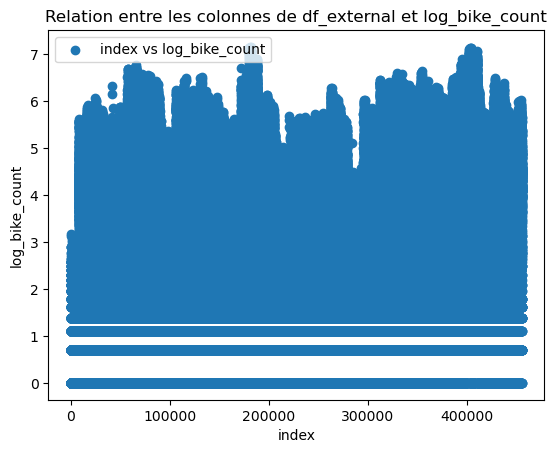

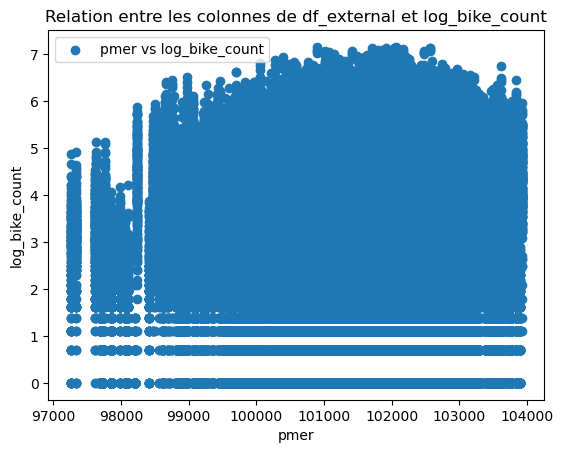

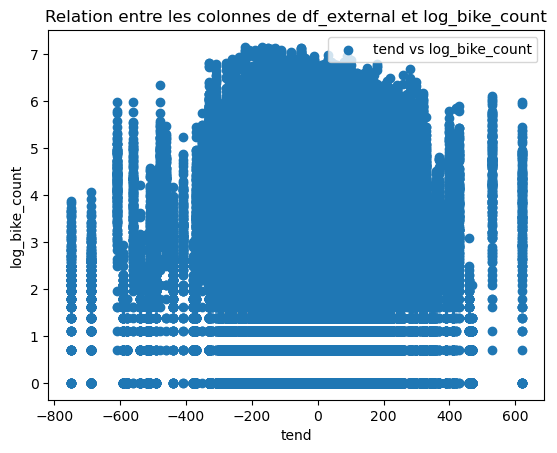

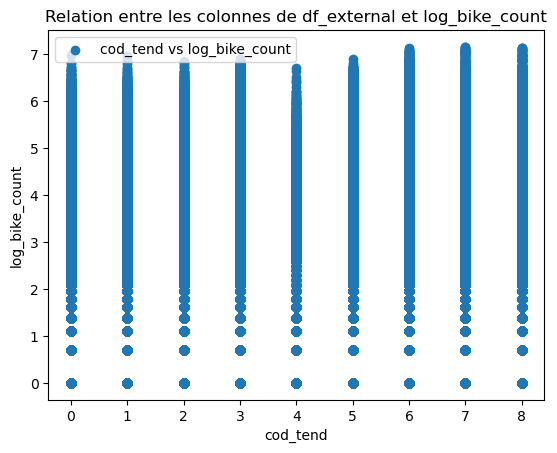

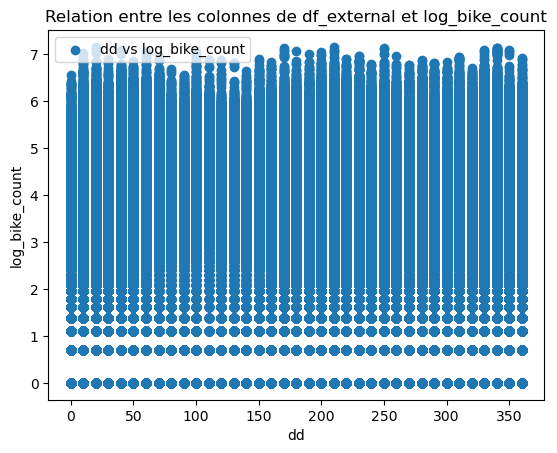

...

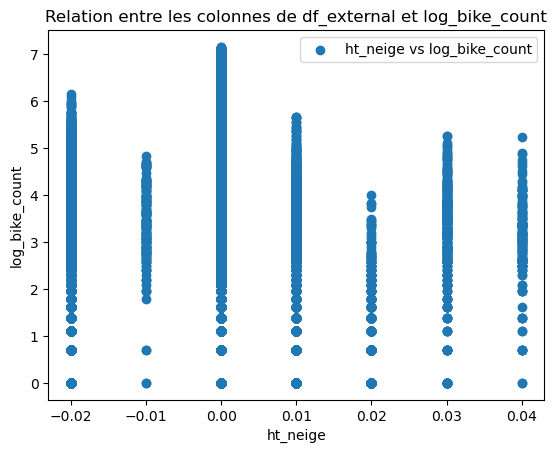

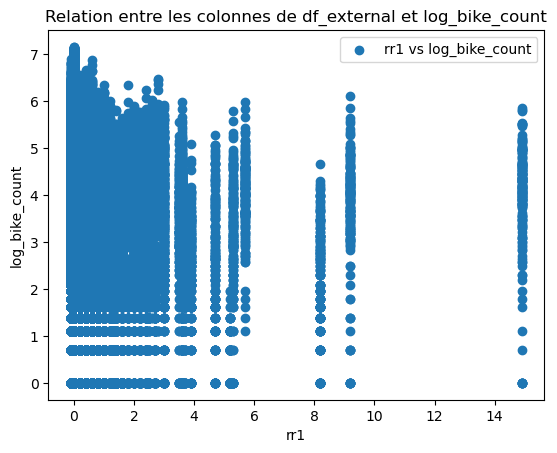

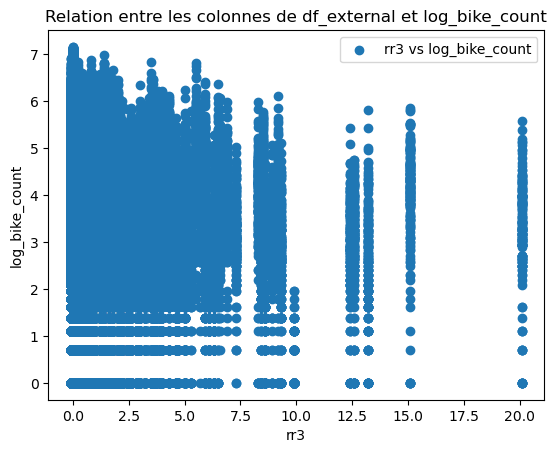

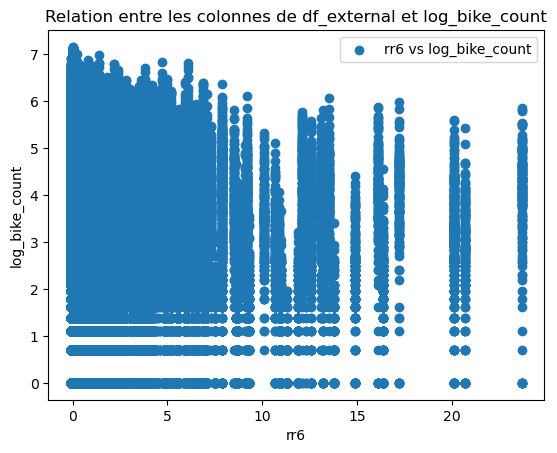

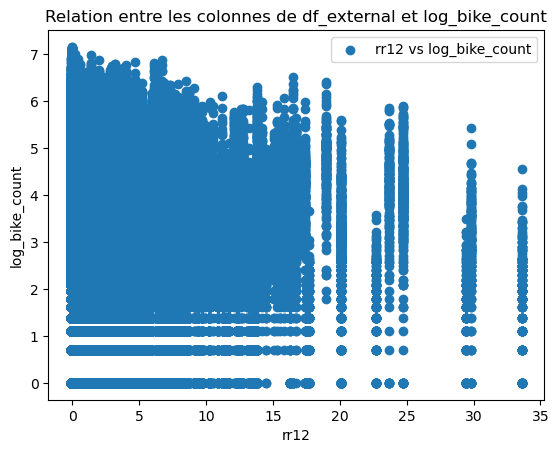

In [137]:
colonnes_list = df_merge.columns.tolist()

# Boucle sur les colonnes de df_external de l'indice 11 à 35
for i in range(11, 36):
    # Sélectionnez la colonne courante
    x = df_merge.iloc[:, i]
    #.mean().sort_index()
    
    # Sélectionnez la colonne "log_bike_count"
    y = df_merge["log_bike_count"]
    
    # Créez un nuage de points
    plt.scatter(x, y, label=f'{colonnes_list[i]} vs log_bike_count')

    # Ajoutez des labels et une légende
    plt.xlabel(colonnes_list[i])
    plt.ylabel('log_bike_count')
    plt.title('Relation entre les colonnes de df_external et log_bike_count')
    plt.legend()
    plt.show()


We will aggregate because there are too much point

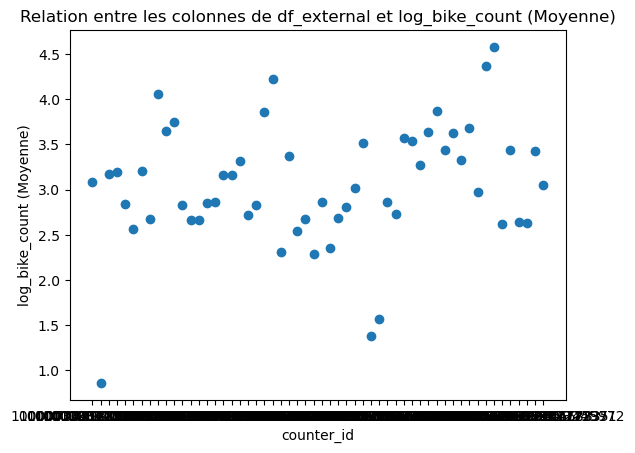

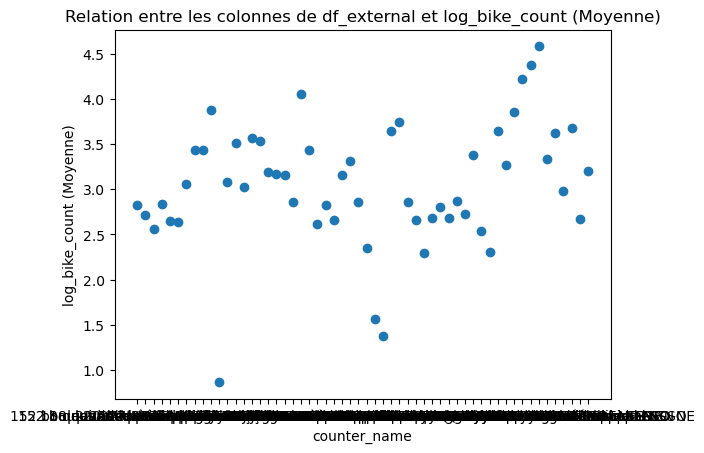

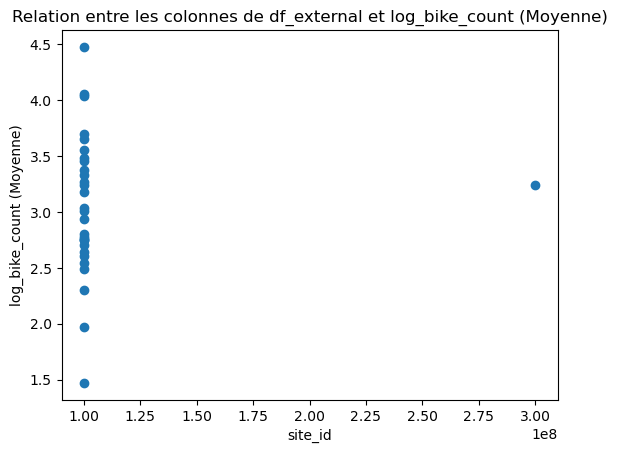

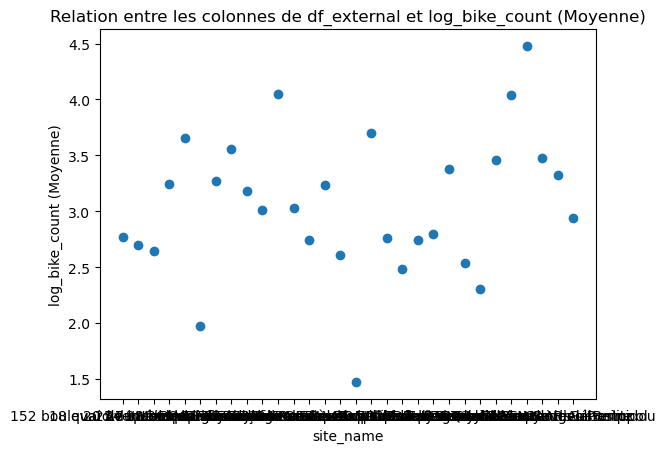

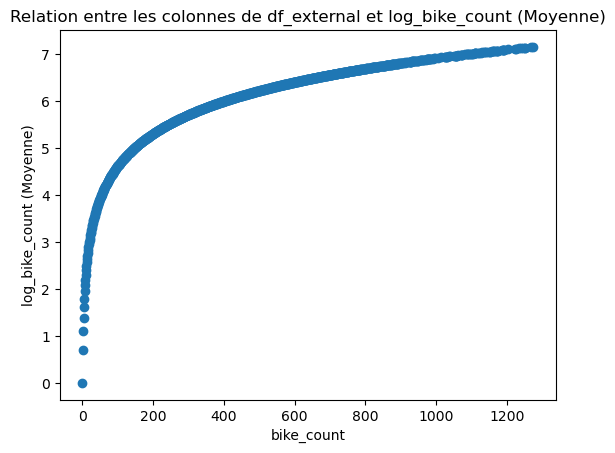

...

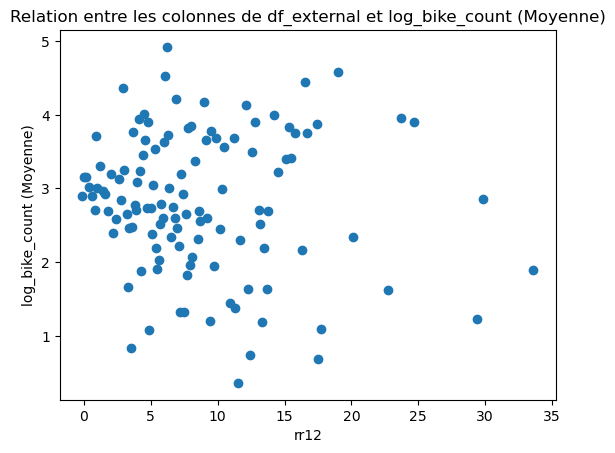

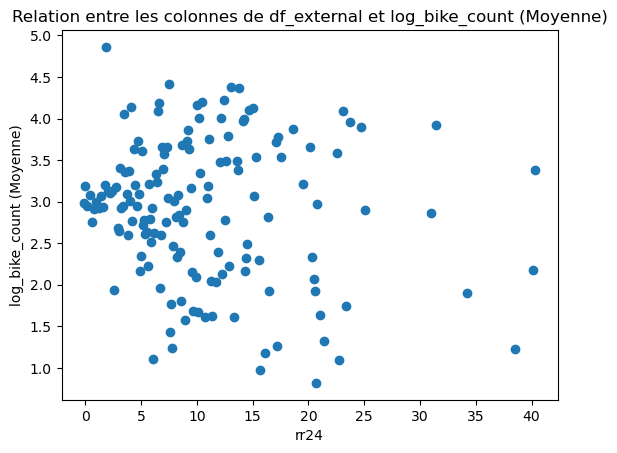

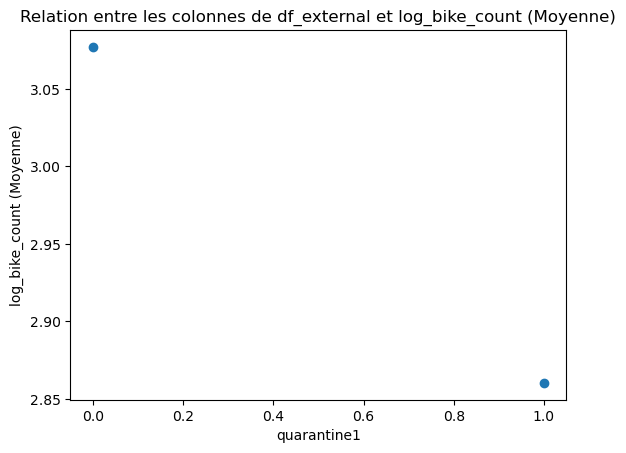

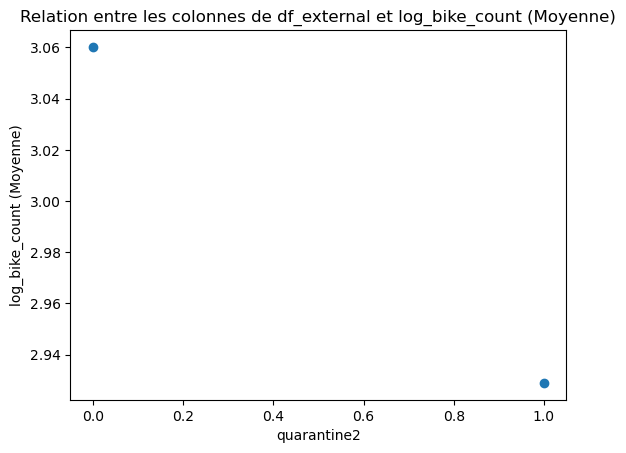

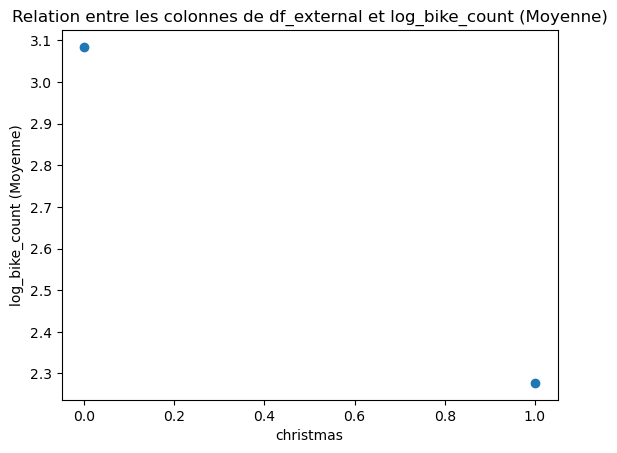

In [138]:
import matplotlib.pyplot as plt

# Boucle sur les colonnes de df_external de l'indice 11 à 35
#for i in range(11, 40):
for i in range(0, 40):
    # Sélectionnez la colonne courante
    x = df_merge.iloc[:, i]
    
    # Sélectionnez la colonne "log_bike_count"
    y = df_merge["log_bike_count"]
    
    # Créez un DataFrame temporaire pour regrouper et calculer la moyenne
    temp_df = pd.DataFrame({'x': x, 'y': y})
    temp_df_grouped = temp_df.groupby('x').mean().reset_index()
    
    # Créez un nuage de points avec les valeurs agrégées
    plt.scatter(temp_df_grouped['x'], temp_df_grouped['y'])

    # Ajoutez des labels et une légende
    plt.xlabel(colonnes_list[i])
    plt.ylabel('log_bike_count (Moyenne)')
    plt.title('Relation entre les colonnes de df_external et log_bike_count (Moyenne)')
 

    # Affichez chaque sous-plot séparément
    plt.show()


Some variable of the exernal dataset seams to have a good relationship (not necessarly linear) with the log_bike_count.


However many predictors do not have linear relationship with the output variable and therefore, Ridge regression would be a poor choice of model if we were not transforming the predictors. 

The most interesting predictors are: `u`,`etat_sol`, `cod_tend`, `td`and `t`have strong linear relationship with `log_bike_count`and therefore should be included in the model.

The rest of the predictors should be tested, but with these plots we already have a baseline for which predictors should be included. <br>

Columns:
looks good: `cod_tend`,`etat_sol`, `t`, `u`, `holiday`, `bank_holiday`, `christmas`, `quarantine1`, `quarantine2`, `christmas_hols` <br>
looks Ok: `pmer`,`td`, `ff`, `tend`,`raf10`,`rafper`,`w1`,`w2`,  <br>
looks Bad:`dd`,`vv`,`n`, `ww`,`pres`,`tend24`,`ht_neige`,  `rr1` , `nbas`, `rr3` , `rr6` , `rr12`, `rr24` <br>


# Attention important

In [ ]:
df_merge = df_merge.sort_values("index")
df_merge

In [96]:
target = df_merge["log_bike_count"]

In [97]:
df_merge['quarantine1'] = df_merge['quarantine1'].astype(bool)
df_merge['quarantine2'] = df_merge['quarantine2'].astype(bool)
df_merge['christmas'] = df_merge['christmas'].astype(bool)

In [98]:
numerical_columns = df_merge.select_dtypes(include=['float', 'int'])
categorical_columns = df_merge.select_dtypes(include=['object', 'category'])
bool_columns = df_merge.select_dtypes(include=['bool'])

In [99]:
target

107       0.000000
157       0.693147
193       0.000000
769       1.609438
959       2.302585
            ...   
453515    3.951244
453934    0.693147
454316    4.127134
454411    3.806662
454785    4.430817
Name: log_bike_count, Length: 455163, dtype: float64

In [100]:
bool_columns

,quarantine1,quarantine2,christmas,holiday,bank_holiday
107,False,False,False,False,False
157,False,False,False,False,False
193,False,False,False,False,False
769,False,False,False,False,False
959,False,False,False,False,False
...,...,...,...,...,...
453515,False,False,False,True,False
453934,False,False,False,True,False
454316,False,False,False,True,False
454411,False,False,False,True,False


In [101]:
categorical_columns

,counter_id,counter_name,site_name,counter_technical_id
107,100007049-102007049,28 boulevard Diderot E-O,28 boulevard Diderot,Y2H15027244
157,100007049-102007049,28 boulevard Diderot E-O,28 boulevard Diderot,Y2H15027244
193,100007049-102007049,28 boulevard Diderot E-O,28 boulevard Diderot,Y2H15027244
769,100007049-102007049,28 boulevard Diderot E-O,28 boulevard Diderot,Y2H15027244
959,100007049-102007049,28 boulevard Diderot E-O,28 boulevard Diderot,Y2H15027244
...,...,...,...,...
453515,300014702-353245971,254 rue de Vaugirard SO-NE,254 rue de Vaugirard,Y2H20114504
453934,300014702-353245971,254 rue de Vaugirard SO-NE,254 rue de Vaugirard,Y2H20114504
454316,300014702-353245971,254 rue de Vaugirard SO-NE,254 rue de Vaugirard,Y2H20114504
454411,300014702-353245971,254 rue de Vaugirard SO-NE,254 rue de Vaugirard,Y2H20114504


In [102]:
numerical_columns

,site_id,bike_count,latitude,longitude,log_bike_count,index_x,pmer,tend,cod_tend,dd,ff,t,td,u,vv,ww,w1,w2,n,nbas,pres,tend24,raf10,rafper,etat_sol,ht_neige,rr1,rr3,rr6,rr12,rr24,index_y
107,100007049,0.0,48.846028,2.375429,0.000000,1,102050,-10,8,340,1.6,285.75,282.55,81,30000,1,0.0,0.0,0.0,0.0,100960,120.0,2.4,3.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3083
157,100007049,1.0,48.846028,2.375429,0.693147,2,101990,-60,6,290,1.1,283.95,282.05,88,25000,2,0.0,0.0,0.0,0.0,100900,0.0,1.5,1.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3084
193,100007049,0.0,48.846028,2.375429,0.000000,3,101990,-60,6,290,1.1,283.95,282.05,88,25000,2,0.0,0.0,0.0,0.0,100900,0.0,1.5,1.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3084
769,100007049,4.0,48.846028,2.375429,1.609438,4,101740,-110,6,40,4.0,293.65,279.95,41,30000,3,2.0,2.0,60.0,5.0,100690,-260.0,7.5,7.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3088
959,100007049,9.0,48.846028,2.375429,2.302585,5,101760,10,3,20,3.0,292.15,280.55,47,30000,2,2.0,2.0,90.0,7.0,100700,-210.0,6.5,6.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3089
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
453515,300014702,51.0,48.839770,2.301980,3.951244,455159,101440,60,3,240,4.1,293.05,283.15,53,25000,3,2.0,2.0,90.0,3.0,100390,940.0,7.2,10.1,0.0,0.0,0.0,0.0,0.0,0.2,0.2,2897
453934,300014702,1.0,48.839770,2.301980,0.693147,455160,101670,30,2,220,2.3,288.65,285.05,79,25000,1,2.0,2.0,75.0,6.0,100600,680.0,3.5,5.4,0.0,0.0,0.0,0.0,0.0,0.0,0.2,2899
454316,300014702,61.0,48.839770,2.301980,4.127134,455161,101740,80,3,180,3.3,287.15,285.15,88,19690,3,2.0,2.0,90.0,7.0,100660,590.0,4.5,4.7,0.0,0.0,0.0,0.0,0.0,0.0,0.2,2901
454411,300014702,44.0,48.839770,2.301980,3.806662,455162,101810,80,1,200,3.5,289.75,287.25,85,20000,1,2.0,2.0,75.0,5.0,100740,530.0,5.1,6.6,0.0,0.0,0.0,-0.1,-0.1,-0.1,0.2,2902


# AUTOMATISATION TO ADD NEW DATA TO OUR DATASET

In [1]:
from vacances_scolaires_france import SchoolHolidayDates
from jours_feries_france import JoursFeries
from datetime import datetime
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sklearn


def data_constructor(data):
    df_original = data
    df_original['index'] = range(1, len(df_original) + 1)
   # open the data file
    df_external = pd.read_csv("/Users/dnn/Data Science for Business 23-25/Master 1 - X/Python for Data Science/Sam_Solal_projet/submissions/external_data/external_data.csv")

    # create the quarantine columns
    df_external["quarantine1"] = np.where(
        (df_external["date"] <= "2020-12-15") & (df_external["date"] >= "2020-10-30"), 1, 0)
    df_external["quarantine2"] = np.where(
        (df_external["date"] <= "2021-05-03") & (df_external["date"] >= "2021-04-03"), 1, 0)
    df_external["christmas"] = np.where(
        (df_external["date"] >= "2020-12-19") & (df_external["date"] <= "2021-01-03"), 1, 0)

    #creating two new variables, holiday and bank_holiday to represent whether a given date is a school holiday or a bank holiday
    hol = SchoolHolidayDates()

    df_external['holiday'] = df_external.apply(
        lambda row: hol.is_holiday_for_zone(datetime.strptime(row["date"], '%Y-%m-%d %H:%M:%S').date(), 'C'), axis=1)

    df_external['bank_holiday'] = df_external.apply(
        lambda row: JoursFeries.is_bank_holiday(datetime.strptime(row["date"], '%Y-%m-%d %H:%M:%S').date(), zone="Métropole"), axis=1)
    
    
       # Obtenez le nombre total de lignes dans le DataFrame externe
    n_rows = df_external.shape[0]

    # Calculez la proportion de valeurs manquantes pour chaque colonne
    proportion_missing_values = df_external.isnull().sum() / n_rows

    # Sélectionnez les colonnes à supprimer (avec un seuil de 10% de valeurs manquantes)
    columns_to_drop = proportion_missing_values[proportion_missing_values >= 0.05].index

    # Supprimez les colonnes sélectionnées du DataFrame externe
    df_external = df_external.drop(columns=columns_to_drop)
    
    
    # Remplace les valeurs manquantes par la médiane
    df_external = df_external.fillna(df_external.median(numeric_only=True))

    df_external['date'] = pd.to_datetime(df_external['date'], errors='coerce')

    df_merge = pd.merge_asof(df_original.sort_values("date"), df_external.sort_values("date"), on="date")
    
    df_merge = df_merge.sort_values("index")
    
    return df_merge
    
   
 

In [2]:
# Read the data

data_train = pd.read_parquet("/Users/dnn/Data Science for Business 23-25/Master 1 - X/Python for Data Science/Sam_Solal_projet/data/train.parquet")
data_test = pd.read_parquet("/Users/dnn/Data Science for Business 23-25/Master 1 - X/Python for Data Science/Sam_Solal_projet/data/test.parquet")
data_final_test = pd.read_parquet("/Users/dnn/Data Science for Business 23-25/Master 1 - X/Python for Data Science/Sam_Solal_projet/data/final_test.parquet")
kaggle_train =  pd.read_parquet("/Users/dnn/Data Science for Business 23-25/Master 1 - X/Python for Data Science/Sam_Solal_projet/data/kaggle_train.parquet")


In [3]:
# Add to those dataset the new data (external and boolean)

data_train_merge = data_constructor(data_train)
data_test_merge = data_constructor(data_test)
kaggle_train_merge = data_constructor(kaggle_train)
final_test_merge = data_constructor(data_final_test)

In [4]:
# Transform those new dataset into parquet file tonuse them on kaggle

data_train_merge = data_train_merge.to_parquet("data_train_merge.parquet")
data_test_merge = data_test_merge.to_parquet("data_test_merge.parquet")
data_final_test_merge = final_test_merge.to_parquet("data_final_test_merge.parquet")
kaggle_train_merge = kaggle_train_merge.to_parquet("kaggle_train_merge.parquet")